In [1]:
#import libraries
import numpy as np
import pandas as pd
import pickle
import time
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
from pandas.tseries.offsets import MonthEnd

from sklearn.preprocessing import LabelEncoder

#Settings
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
pd.options.display.max_columns = None
pd.options.display.float_format = '{:.2f}'.format
pd.set_option('display.max_colwidth', -1)
pd.set_option('display.max_rows', 500)
from IPython.core.interactiveshell import InteractiveShell  
InteractiveShell.ast_node_interactivity = "all"
seed = 123

## EDA and Data Cleaning

In [2]:
df = pd.read_csv('../DBS_DA/data/train.csv')
df.head()

,id,industry,state,request_date,term,employee_count,business_new,business_type,location,other_loans,loan_amount,insured_amount,default_status
0,4050975007,Others,VA,27-Apr-10,34,4,New,0,Rural,N,"$35,000.00","$35,000.00",1
1,3735095001,Manufacturing,CA,05-Nov-09,107,1,New,0,Rural,N,"$15,000.00","$13,500.00",1
2,3936555004,Trading,CA,26-Feb-10,84,1,New,0,Rural,Y,"$265,000.00","$100,000.00",0
3,4130405000,Engineering,MI,10-Jun-10,240,21,New,0,Rural,N,"$255,000.00","$255,000.00",0
4,4263615008,Education,NH,23-Sep-10,36,1,Existing,0,Rural,N,"$13,300.00","$6,650.00",0


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2402 entries, 0 to 2401
Data columns (total 13 columns):
id                2402 non-null int64
industry          2401 non-null object
state             2402 non-null object
request_date      2402 non-null object
term              2402 non-null int64
employee_count    2402 non-null int64
business_new      2402 non-null object
business_type     2402 non-null int64
location          2402 non-null object
other_loans       2402 non-null object
loan_amount       2402 non-null object
insured_amount    2402 non-null object
default_status    2402 non-null int64
dtypes: int64(5), object(8)
memory usage: 244.1+ KB


In [4]:
df.isnull().sum()
#there is 1 null value in industry

id                0
industry          1
state             0
request_date      0
term              0
employee_count    0
business_new      0
business_type     0
location          0
other_loans       0
loan_amount       0
insured_amount    0
default_status    0
dtype: int64

In [5]:
df.loc[df['industry'].isnull()]

,id,industry,state,request_date,term,employee_count,business_new,business_type,location,other_loans,loan_amount,insured_amount,default_status
1946,3771775001,NaN,NH,20-Nov-09,12,1,New,0,Rural,N,$100.00,"$75,000.00",0


In [7]:
df.industry.value_counts()
# trading is the most common industry
# kiv grouping rare industries e.g finance, entertainment, education, energy as others

Trading           508
Construction      275
Consulting        267
Hotel             245
Manufacturing     245
Healthcare        219
Others            168
Administration    125
Transportation    106
Agriculture       58 
Real Estate       44 
Engineering       40 
Finance           32 
Entertainment     31 
Education         29 
Energy            9  
Name: industry, dtype: int64

In [8]:
#since 'industry' is a categorical variable, as an mvp, i impute this missing value with the mode (i.e trading)
#my next step would involve using clustering to determine the name of industry based on other features (e.g. 
#state, term, employee_count and other variables)
df1 = df.copy()
df1.loc[df1['industry'].isnull(),'industry'] = 'Trading'

In [9]:
#convert date from string to datetime object
df1['request_date'] = pd.to_datetime(df1['request_date'])

In [10]:
df1.request_date.min()
df1.request_date.max()
#data span from 1 Oct 2009 to 30 Sept 2010

Timestamp('2009-10-01 00:00:00')

Timestamp('2010-09-30 00:00:00')

In [11]:
#extract more features from date
def date_feature_extraction(df, date):
    df['day_of_week'] = df[date].dt.dayofweek + 1
    df['is_weekend'] = np.where(df['day_of_week'].isin([6,7]),1,0)
    df['month'] = df[date].dt.month
    df['first_day_of_month'] = df[date].values.astype('datetime64[M]')
    df['last_day_of_month'] = pd.to_datetime(df[date], format="%Y%m") + MonthEnd(1)

    last_day_of_month = df['last_day_of_month'].dt.date.values.tolist()
    first_day_of_month = df['first_day_of_month'].dt.date.values.tolist()
    
    df['is_last_day_of_month'] = np.where(df[date].isin(last_day_of_month),1,0)
    df['is_first_day_of_month'] = np.where(df[date].isin(first_day_of_month),1,0)
    df['week_number'] = df[date].dt.week
    df['week_number'].value_counts()
    return df

In [12]:
df2 = date_feature_extraction(df1, 'request_date')

In [13]:
df2.default_status.value_counts()
#default status classes are slightly imbalanced. 
#would use metrics such as recall, precision, f1, auc, log loss cross entropy instead of accuracy

0    1629
1    773 
Name: default_status, dtype: int64

count   2402.00
mean    87.61  
std     62.67  
min     1.00   
25%     52.00  
50%     84.00  
75%     95.00  
max     312.00 
Name: term, dtype: float64

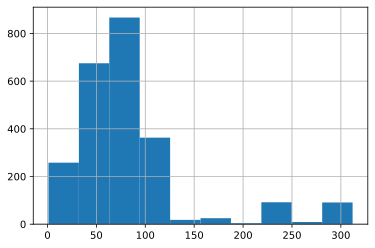

In [14]:
df2.term.hist()
df2.term.describe()
#most of the loans are to be repaid between 50 to 100 (months I assume?), but there are 
#some outliers of beyond 150

count   2402.00
mean    9.29   
std     21.23  
min     0.00   
25%     2.00   
50%     4.00   
75%     9.00   
max     500.00 
Name: employee_count, dtype: float64

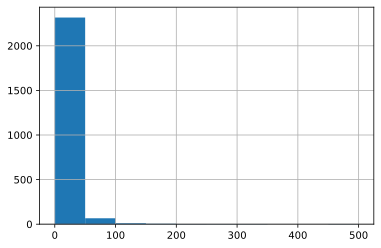

In [15]:
df2.employee_count.hist()
df2.employee_count.describe()
#most companies have less than 10 employees. but there are outliers with 500 employees. 

In [16]:
df2.business_new.value_counts()
df2.business_type.value_counts()

New         1687
Existing    715 
Name: business_new, dtype: int64

0    2270
1    132 
Name: business_type, dtype: int64

In [17]:
df2.location.value_counts()
#since there is no variation in location, will exclude this feature when building model

Rural    2402
Name: location, dtype: int64

In [18]:
df2.other_loans.value_counts()
# most companies don't have record of taking up other loans 

N    1741
Y    661 
Name: other_loans, dtype: int64

In [19]:
#retain only numbers in `loan_amount`, `insured_amount` 
numerical_variables = ['loan_amount', 'insured_amount']
for variable in numerical_variables:
    df2[variable] = df2[variable].str.extract('(\d[0-9,.]+)')
    #remove comma before the ,000
    df2[variable] = df2[variable].str.replace(',', '')
    #convert object to float dtype
    df2[variable] = df2[variable].astype(float)
df2.sample(1)

,id,industry,state,request_date,term,employee_count,business_new,business_type,location,other_loans,loan_amount,insured_amount,default_status,day_of_week,is_weekend,month,first_day_of_month,last_day_of_month,is_last_day_of_month,is_first_day_of_month,week_number
1590,4022925006,Trading,IA,2010-04-12,36,1,Existing,0,Rural,N,21000.00,10500.00,1,1,0,4,2010-04-01,2010-04-30,0,0,15


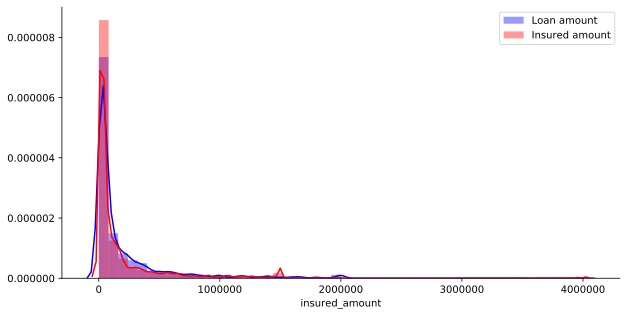

In [20]:
#plot loan_amount and insured_amount
fig = plt.figure(figsize = (10,5))
sns.distplot(df2["loan_amount"] , color="blue", label="Loan amount")
sns.distplot(df2["insured_amount"] , color="red", label="Insured amount")
plt.legend(loc='upper right')
sns.despine();
#most companies were granted the amount they requested. 

In [21]:
df2["loan_amount"].describe()
df2["insured_amount"].describe()
#most loans were below $500k, and there are outliers 

count   2402.00   
mean    204487.70 
std     364335.56 
min     100.00    
25%     25000.00  
50%     50000.00  
75%     216492.50 
max     4000000.00
Name: loan_amount, dtype: float64

count   2402.00   
mean    155016.69 
std     311422.68 
min     1700.00   
25%     12750.00  
50%     35000.00  
75%     125000.00 
max     4000000.00
Name: insured_amount, dtype: float64

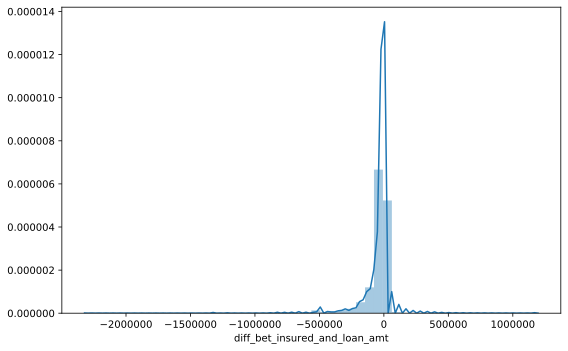

count   2402.00    
mean    -49471.02  
std     119226.80  
min     -2297866.00
25%     -50000.00  
50%     -15000.00  
75%     -2000.00   
max     1172540.00 
Name: diff_bet_insured_and_loan_amt, dtype: float64

In [22]:
df2['diff_bet_insured_and_loan_amt'] = df2["insured_amount"]-df2["loan_amount"]
fig = plt.figure(figsize=(8, 5))
ax = sns.distplot(df2['diff_bet_insured_and_loan_amt'])
plt.tight_layout()
plt.show();

df2['diff_bet_insured_and_loan_amt'].describe()
#there are more companies who were granted less than what they requested, c.f those who
#received more than their requested amount

In [23]:
#convert string object to numeric 
def is_new(x):
    if x == 'New':
        return 1
    else:
        return 0
df2['business_new_int'] = df2['business_new'].apply(is_new)
df2.business_new_int.value_counts()

1    1687
0    715 
Name: business_new_int, dtype: int64

In [24]:
#convert string object to numeric 
def has_other_loans(x):
    if x == 'Y':
        return 1
    else:
        return 0
df2['other_loans_int'] = df2['other_loans'].apply(has_other_loans)
df2.other_loans_int.value_counts()

0    1741
1    661 
Name: other_loans_int, dtype: int64

count   2402.00  
mean    2356.03  
std     13075.54 
min     28.93    
25%     226.70   
50%     604.14   
75%     1737.43  
max     498000.00
Name: repayment_amt_per_term, dtype: float64

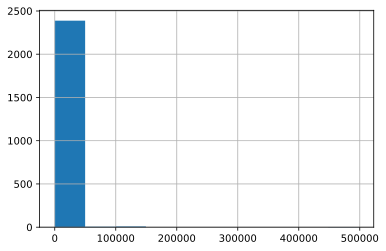

In [25]:
# create a new feature - amount to be repaid per term
df2['repayment_amt_per_term'] = df2['insured_amount'] / df2['term']
df2['repayment_amt_per_term'].hist()
df2['repayment_amt_per_term'].describe()
# the repayment amount per term for most companies is below $50k

## Feature Selection
### Using correlation between features, correlation with target, pairplot, average default rate for each category within features and information value

In [27]:
numerical_variables = [i for i in df2.select_dtypes(include = ['float64', 'int64']).columns if i != 'id']
numerical_variables

['term',
 'employee_count',
 'business_type',
 'loan_amount',
 'insured_amount',
 'default_status',
 'day_of_week',
 'is_weekend',
 'month',
 'is_last_day_of_month',
 'is_first_day_of_month',
 'week_number',
 'diff_bet_insured_and_loan_amt',
 'business_new_int',
 'other_loans_int',
 'repayment_amt_per_term']

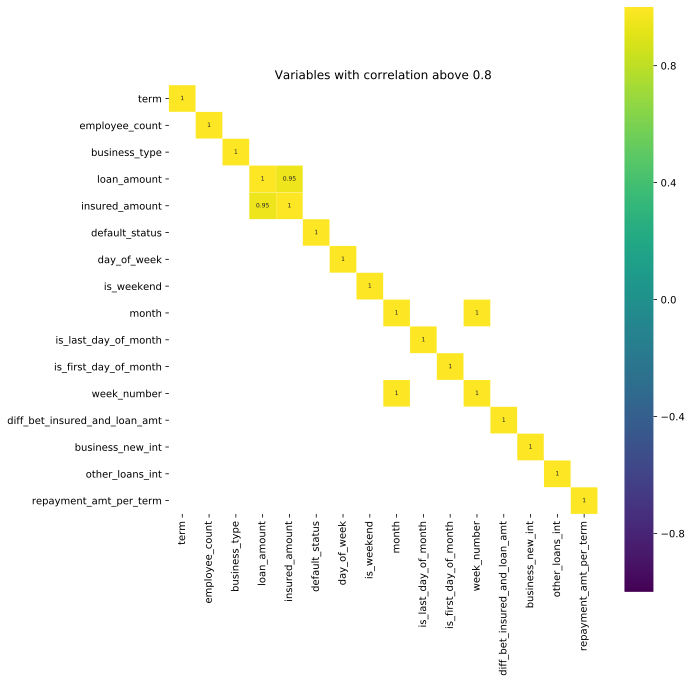

In [28]:
#correlation between features
num_variables_corr = df2[numerical_variables].corr() 
fig = plt.figure(figsize=(10, 10))
ax = sns.heatmap(num_variables_corr[(num_variables_corr >= 0.8) | (num_variables_corr <= -0.8)],  #view correlations that are greater than abs(0.8)
            cmap='viridis', vmax=1.0, vmin=-1.0, linewidths=0.1,
            annot=True, annot_kws={"size": 6}, square=True)
ax.set_title('Variables with correlation above 0.8')
plt.tight_layout()
plt.show();
#loan amount is highly correlated with insured amount. 
#exclude insured amount when building model 

In [29]:
df_num_corr = df2[numerical_variables].corr() ['default_status'][:-1]
golden_features_list = df_num_corr[abs(df_num_corr) > 0.5].sort_values(ascending=False)
print("There is {} strongly correlated values with default_status:\n{}".format(len(golden_features_list), golden_features_list))
# there are no features that are strongly correlated (above 0.5) with target besides the target itself

There is 1 strongly correlated values with default_status:
default_status   1.00
Name: default_status, dtype: float64


In [30]:
sorted(list(zip(df2[numerical_variables].columns, df_num_corr.round(2))),key=lambda x: x[1], reverse = True)

# `diff_bet_insured_and_loan_amt` had the strongest positive correlation to `default status`. This means, a bigger 
# difference between insured and loan amount (i.e. if the bank loans more than is requested), is correlated with 
# a higher likelihood of default

# `loan_amount` and `term` had the strongest negative correlation to `default status`.
# a lower term and is correlated with a higher likelihood of default

# unexpectedly, a smaller loan amount is correlated with a higher likelihood of default

# whether it `is_weekend` or `day_of_week` has negligible association with defaulting

[('default_status', 1.0),
 ('diff_bet_insured_and_loan_amt', 0.17),
 ('month', 0.06),
 ('week_number', 0.06),
 ('is_last_day_of_month', 0.03),
 ('business_new_int', 0.03),
 ('day_of_week', 0.0),
 ('is_weekend', -0.0),
 ('business_type', -0.03),
 ('is_first_day_of_month', -0.03),
 ('employee_count', -0.14),
 ('other_loans_int', -0.14),
 ('insured_amount', -0.22),
 ('term', -0.24),
 ('loan_amount', -0.25)]

In [31]:
# study the feature-target relationships and look for separability (i.e distribution of 
# defaulters and non-defaulters class for each feature is as distinct as possible)
def plot_features(df):
    fig = plt.figure(figsize = (15,15))
    ax = sns.pairplot(df,hue='default_status', plot_kws=dict(alpha=.3, edgecolor='none'))
    plt.legend(loc='upper right')
    plt.show();

In [32]:
df2_sample = df2.sample(frac=0.2, replace=False, random_state=seed) #generate a reproducible sample of df2    
plot_features(df2_sample[numerical_variables])

# orange refers to defaulters class
# `term`, `loan amount`, `week_number`, `other_loans_int`, `day_of_week`, `month` seem to 
# be able to separate defaulters and non-defaulters class quite well

/Users/admin/anaconda3/envs/metis/lib/python3.7/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/Users/admin/anaconda3/envs/metis/lib/python3.7/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


<Figure size 1080x1080 with 0 Axes>

In [33]:
# group these numeric features into quintiles, to calculate the average default rate for
# each quintile, and to calculate information value which requires features to be 
# categorical 
numeric_features = ['term', 'employee_count', 'loan_amount', 'week_number', 'diff_bet_insured_and_loan_amt', 'repayment_amt_per_term']
for num_feature in df2[numeric_features].columns:
    num_feature_label_encode = ('%s_quintiles' % num_feature)
    df2[num_feature_label_encode] = pd.qcut(df2[num_feature], q=5, precision=0,duplicates='drop')

In [34]:
# label encode non numeric features so as to calculate the average default rate and 
# information value
non_numeric_features = ['industry', 'state']
labelencoder = LabelEncoder()
for feature in df2[non_numeric_features].columns:
    feature_name_label_encode = ('%s_label_encoded' % feature)
    df2[feature_name_label_encode] = labelencoder.fit_transform(df2[feature].astype(str))

In [35]:
features = ['day_of_week', 'is_weekend', 'month', 'is_last_day_of_month', 'is_first_day_of_month', 'week_number_quintiles',
           'business_new_int', 'other_loans_int', 'industry_label_encoded', 'state_label_encoded', 'business_type',
            'term_quintiles', 'employee_count_quintiles', 'loan_amount_quintiles', 'diff_bet_insured_and_loan_amt_quintiles',
           'repayment_amt_per_term_quintiles']
for feature in df2[features].columns:
    df2.groupby(feature)['default_status'].mean()
# the average default rate for `is_weekend`, `business_new_int` are very similar across 
# classes. this could suggest they may not be very strong predictors of default. 

# let's look at Information Value to determine if these features should be included 
# in building the model

day_of_week
1   0.32
2   0.31
3   0.35
4   0.30
5   0.34
6   0.31
7   0.40
Name: default_status, dtype: float64

is_weekend
0   0.32
1   0.32
Name: default_status, dtype: float64

month
1    0.39
2    0.33
3    0.25
4    0.25
5    0.22
6    0.29
7    0.27
8    0.35
9    0.38
10   0.40
11   0.36
12   0.36
Name: default_status, dtype: float64

is_last_day_of_month
0   0.32
1   0.41
Name: default_status, dtype: float64

is_first_day_of_month
0   0.32
1   0.23
Name: default_status, dtype: float64

week_number_quintiles
(0.0, 11.0]    0.32
(11.0, 20.0]   0.24
(20.0, 33.0]   0.30
(33.0, 44.0]   0.38
(44.0, 53.0]   0.36
Name: default_status, dtype: float64

business_new_int
0   0.30
1   0.33
Name: default_status, dtype: float64

other_loans_int
0   0.36
1   0.22
Name: default_status, dtype: float64

industry_label_encoded
0    0.32
1    0.19
2    0.43
3    0.33
4    0.21
5    0.11
6    0.38
7    0.26
8    0.34
9    0.18
10   0.38
11   0.23
12   0.36
13   0.34
14   0.36
15   0.25
Name: default_status, dtype: float64

state_label_encoded
0    0.00
1    0.35
2    0.55
3    0.62
4    0.36
5    0.27
6    0.11
7    0.75
8    0.45
9    0.56
10   0.36
11   0.38
12   0.35
13   0.38
14   0.28
15   0.27
16   0.29
17   0.29
18   0.20
19   0.46
20   0.25
21   0.24
22   0.27
23   0.38
24   0.36
25   0.30
26   0.36
27   0.20
28   0.28
29   0.18
30   0.21
31   0.12
32   0.39
33   0.27
34   0.27
35   0.21
36   0.27
37   0.27
38   0.14
39   0.42
40   0.21
41   0.43
42   0.31
43   0.34
44   0.30
45   0.12
46   0.44
47   0.23
48   0.43
49   0.00
Name: default_status, dtype: float64

business_type
0   0.33
1   0.27
Name: default_status, dtype: float64

term_quintiles
(0.0, 46.0]      0.49
(46.0, 66.0]     0.45
(66.0, 84.0]     0.13
(84.0, 108.0]    0.76
(108.0, 312.0]   0.12
Name: default_status, dtype: float64

employee_count_quintiles
(-1.0, 1.0]     0.35
(1.0, 2.0]      0.42
(2.0, 5.0]      0.39
(5.0, 11.0]     0.29
(11.0, 500.0]   0.14
Name: default_status, dtype: float64

loan_amount_quintiles
(99.0, 21000.0]         0.56
(21000.0, 35000.0]      0.50
(35000.0, 87300.0]      0.28
(87300.0, 277660.0]     0.17
(277660.0, 4000000.0]   0.09
Name: default_status, dtype: float64

diff_bet_insured_and_loan_amt_quintiles
(-2297867.0, -63700.0]   0.11
(-63700.0, -25000.0]     0.21
(-25000.0, -8796.0]      0.23
(-8796.0, -1000.0]       0.49
(-1000.0, 1172540.0]     0.56
Name: default_status, dtype: float64

repayment_amt_per_term_quintiles
(28.0, 167.0]        0.44
(167.0, 449.0]       0.30
(449.0, 893.0]       0.46
(893.0, 2160.0]      0.25
(2160.0, 498000.0]   0.17
Name: default_status, dtype: float64

In [36]:
features.append('default_status')
features

['day_of_week',
 'is_weekend',
 'month',
 'is_last_day_of_month',
 'is_first_day_of_month',
 'week_number_quintiles',
 'business_new_int',
 'other_loans_int',
 'industry_label_encoded',
 'state_label_encoded',
 'business_type',
 'term_quintiles',
 'employee_count_quintiles',
 'loan_amount_quintiles',
 'diff_bet_insured_and_loan_amt_quintiles',
 'repayment_amt_per_term_quintiles',
 'default_status']

In [37]:
#info value ranks features based on how well they predict the target. 

def calculate_woe_iv(dataset, feature, target):
    iv_list = []
    for i in range(dataset[feature].nunique()):
        val = list(dataset[feature].unique())[i]
        iv_list.append({
            'Value': val,
            'All': dataset[dataset[feature] == val].count()[feature],
            'No': dataset[(dataset[feature] == val) & (dataset[target] == 0)].count()[feature], #non defaulters class
            'Yes': dataset[(dataset[feature] == val) & (dataset[target] == 1)].count()[feature] #defaulters class
        })
        
    dset = pd.DataFrame(iv_list)
    dset['Distr_Yes'] = dset['Yes'] / dset['Yes'].sum() #proportion of defaulters class
    dset['Distr_No'] = dset['No'] / dset['No'].sum() #proportion of non-defaulters class
    dset['WoE'] = np.log(dset['Distr_Yes'] / dset['Distr_No']) #formula to calculate weight of evidence (woe)
    dset = dset.replace({'WoE': {np.inf: 0, -np.inf: 0}})
    dset['IV'] = (dset['Distr_Yes'] - dset['Distr_No']) * dset['WoE'] 
    iv = dset['IV'].sum() #calculate info value (iv)
    
    dset = dset.sort_values(by='WoE')
    
    return dset, iv

In [38]:
iv_values = []
for col in df2[features].columns:
    if col == 'default_status': continue
    else:
        print('WoE and IV for column: {}'.format(col))
        df, iv = calculate_woe_iv(df2[features], col, 'default_status') 
        iv_values.append(iv.round(2))

WoE and IV for column: day_of_week
WoE and IV for column: is_weekend
WoE and IV for column: month
WoE and IV for column: is_last_day_of_month
WoE and IV for column: is_first_day_of_month
WoE and IV for column: week_number_quintiles
WoE and IV for column: business_new_int
WoE and IV for column: other_loans_int
WoE and IV for column: industry_label_encoded
WoE and IV for column: state_label_encoded


/Users/admin/anaconda3/envs/metis/lib/python3.7/site-packages/pandas/core/series.py:856: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


WoE and IV for column: business_type
WoE and IV for column: term_quintiles
WoE and IV for column: employee_count_quintiles
WoE and IV for column: loan_amount_quintiles
WoE and IV for column: diff_bet_insured_and_loan_amt_quintiles
WoE and IV for column: repayment_amt_per_term_quintiles


In [39]:
list_of_iv_values = sorted(list(zip(features, iv_values)),key=lambda x: x[1], reverse = True)
iv_features_df = pd.DataFrame(list_of_iv_values, columns =['Feature', 'IV_value']) 
iv_features_df

,Feature,IV_value
0,term_quintiles,1.05
1,loan_amount_quintiles,0.81
2,diff_bet_insured_and_loan_amt_quintiles,0.68
3,repayment_amt_per_term_quintiles,0.27
4,employee_count_quintiles,0.22
5,state_label_encoded,0.20
6,industry_label_encoded,0.13
7,other_loans_int,0.09
8,month,0.08
9,week_number_quintiles,0.05


In [ ]:
# using feature-target correlations, pairplots, average default rate between each category in the feature, 
# and Information Value, the following features suggest they may not be strong predictors of default status. 
# hence, they'll be excluded
# `day_of_week`, `is_first_day_of_month`, `is_weekend`, `is_last_day_of_month`, 
# `business_new_int`, `business_type`

In [42]:
# #save df2 in a pickle file
with open('../DBS_DA/data/df2.pkl', 'wb') as to_write:
    pickle.dump(df2, to_write)    

In [ ]:
model_features = ['term', 'loan_amount', 'diff_bet_insured_and_loan_amt', 'repayment_amt_per_term', 
                  'employee_count', 'state_label_encoded', 'industry_label_encoded', 'other_loans_int',
                  'month', 'week_number']

In [ ]:
#i build my models in the next notebook (02-Modelling)